Deep Convolutional Autoencoder
===

Used for feature extraction

In [12]:
import numpy as np
import os, sys
from PIL import Image
import matplotlib.pyplot as plt
import inspect, sys

def loadimgs():
    data=[]
    labels = []
    datadic = {}
    folder = './images'
    try:
        assert os.path.isdir(folder)
        print('Loading images...')
        files = list(filter(lambda x: x.endswith('.png'), os.listdir(folder)))
        for idx, img in enumerate(files[:]):
            image_path = os.path.join(folder, img)
            im = Image.open(image_path)
            im = im.resize((256, 256), Image.ANTIALIAS)
            print(idx, end='\r')
            if image_path.endswith('.png'):
                data.append(np.array(im)[:,:,0])
                labels.append(img)
                datadic[img] = np.array(im)[:,:,0]
        return data, labels, datadic

    except AssertionError:
        sys.exit('Folder does not exist')

In [13]:
data, labels, datadic = loadimgs()

Loading images...


In [34]:
x_train = np.asarray(data)
print(x_train.shape)
x_train = np.expand_dims(x_train, axis=-1)
x_train = x_train / 255

(1000, 256, 256)


In [35]:
from keras.layers import Input, Dense, Conv2D, MaxPooling2D, UpSampling2D, Flatten, Reshape
from keras.models import Model
from keras import backend as K

input_dim = 256

input_img = Input(shape=(input_dim, input_dim, 1))  # adapt this if using `channels_first` image data format

x = Conv2D(16, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)

x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)

x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)

x = Flatten()(x)
encoded = Dense(6)(x)

x = Dense(512)(encoded)
x = Reshape((2, 2, 128))(x)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)

x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)

x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)

x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)

x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)

decoded = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

autoencoder = Model(input_img, decoded)
# Use encoder as predictor
encoder = Model(input_img, encoded)

# Try several loss functions - binary cross entropy worked well
autoencoder.compile(optimizer='adadelta', loss='binary_crossentropy')

In [36]:
autoencoder.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 256, 256, 1)       0         
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 256, 256, 16)      160       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 128, 128, 16)      0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 128, 128, 32)      4640      
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 64, 64, 64)        18496     
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 32, 32, 64)        0         
__________

### Train

In [ ]:
autoencoder.fit(x_train, x_train, epochs=30)

Epoch 1/2
1000/1000 [==============================] - 341s 341ms/step - loss: 0.1273
Epoch 2/2
 864/1000 [========================>.....] - ETA: 45s - loss: 0.1071

In [ ]:
predictions = encoder.predict(x_train)

Write results to CSV

In [12]:
with open('./clustered_3.csv', 'w') as f:
    for label, pred in zip(labels, predictions):
        f.write(label + ',' + str(pred[0]) + ',' + str(pred[1])  + ',' + str(pred[2]) + '\n')
f.close()
print('CLUSTERS WRITTEN!')

CLUSTERS WRITTEN!


Load and visualize encoded images
---

In [104]:
import pandas as pd
df = pd.read_csv('./clustered_entropy.csv', header=None)
df.columns = ['label', 'x', 'y', 'z']
df.head()

,label,x,y,z
0,_Port of Spain.png,-10.053673,3.362716,5.916826
1,_El Paso.png,5.989289,1.122345,-2.298684
2,CL_545.png,1.167437,5.708115,-3.582084
3,MX_825.png,3.094105,2.346902,-2.381266
4,Almere_39.png.png,12.119444,2.184424,-0.324675


In [17]:
many = 49
fig,ax = plt.subplots(figsize=(50,50), dpi=300)
plt.scatter(df['x'][:many], df['y'][:many], c=df['z'][:many])
for idx in range(many):
    plt.text(df['x'][idx], df['y'][idx], df['label'][idx])
ax.set_axis_off()
plt.show()
fig.savefig('./plot.png')

### Cluster encoded data 
Use K-Means to group similar individuals

In [2]:
from sklearn.cluster import KMeans

def kMeans(df_train,number_clusters=1):
    '''Plots k-means clustering after getting optimal number via Elbow Method
    '''
    print('Performing K-Means for {0} clusters...'.format(number_clusters))
    ## Fitting K-Means to the dataset
    kmeans = KMeans(n_clusters = number_clusters, init = 'k-means++')

    y_kmeans = kmeans.fit_predict(df_train)
    print(y_kmeans)
    return y_kmeans

Set up naming conventions

In [3]:
def setup(name, number_clusters, ndim):
    dir_current = os.path.dirname(os.path.abspath(inspect.getfile(inspect.currentframe())))
    dir_parent = os.path.dirname(os.path.dirname(dir_current))
    print(dir_current)
    
    pathname = os.path.join(dir_current, '_project', 'images', 'clustered','{0}_{1}d__cl{2}'.format(name, ndim, str(number_clusters)))

    if not os.path.exists(pathname):
        os.makedirs(pathname)
    print(pathname)
    return pathname


Plot array of clustered images for comparison

In [4]:
def showBatch(pathname, cluster, r=5, c=8):
    # Get some random indeces
    dg = df[df['cluster']==cluster].reset_index()
    idcs = list(np.random.randint(0, len(dg), r*c))
    dg = dg.loc[idcs]

    fig, axs = plt.subplots(r, c, figsize=(2.5*c,2.5*r), dpi=300)
    cnt = 0
    for i in range(r):
        for j in range(c):
            label = dg.iloc[cnt]
            axs[i,j].imshow(datadic[label['label']], cmap='gray')
            axs[i,j].axis('off')
            cnt += 1
            
    fig.savefig(os.path.join(pathname, '{0}_{1}d__cluster_{2}.png'.format(name, ndim, str(cluster))))
    plt.show()
    plt.close()

In [10]:
name = 'cross_entropy'
number_clusters = 12
ndim = 10
import pandas as pd
df = pd.read_csv('./clustered_entropy_10d.csv', header=None)
if ndim == 3 : df.columns = ['label', 'x', 'y', 'z']
elif ndim == 10 : df.columns = ['label', 'd0', 'd1', 'd2', 'd3', 'd4', 'd5', 'd6', 'd7', 'd8','d9']
else: df.columns = ['label', 'x', 'y']
df.head()

,label,d0,d1,d2,d3,d4,d5,d6,d7,d8,d9
0,_Port of Spain.png,-8.264128,4.345675,15.348310,-11.734164,19.209822,13.198437,0.197000,13.230757,-2.161071,3.893851
1,_El Paso.png,2.804946,-11.202981,-4.450845,-0.556786,-13.926937,-9.234997,4.715418,-15.249118,4.827555,5.919183
2,CL_545.png,-7.425471,5.383985,4.639398,-3.609730,-12.732849,-6.912339,8.135488,-6.286479,-7.160265,-11.421197
3,MX_825.png,-5.198417,-4.552832,2.174224,0.845224,-11.177009,-5.075975,5.756759,-13.767354,0.901183,1.006248
4,Almere_39.png.png,11.889912,-15.635679,-5.190125,11.827231,-27.183287,-10.772720,19.970423,-17.741695,-3.979375,12.819590


C:\Users\lhrfxg\workspace\1902_fastai
C:\Users\lhrfxg\workspace\1902_fastai\_project\images\clustered\cross_entropy_10d__cl12
Performing K-Means for 12 clusters...
[5 7 3 ... 7 6 2]


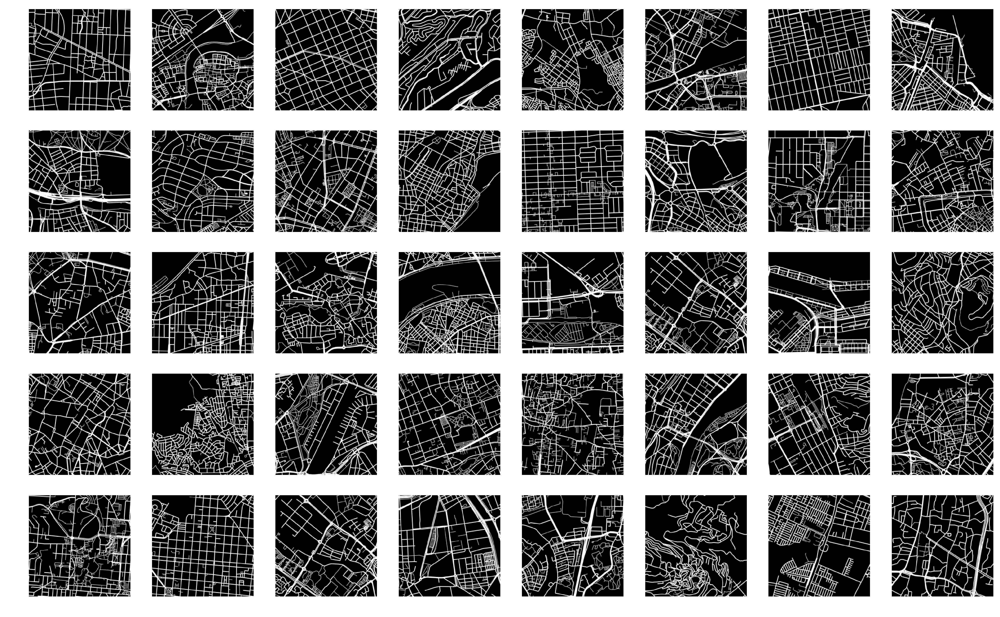

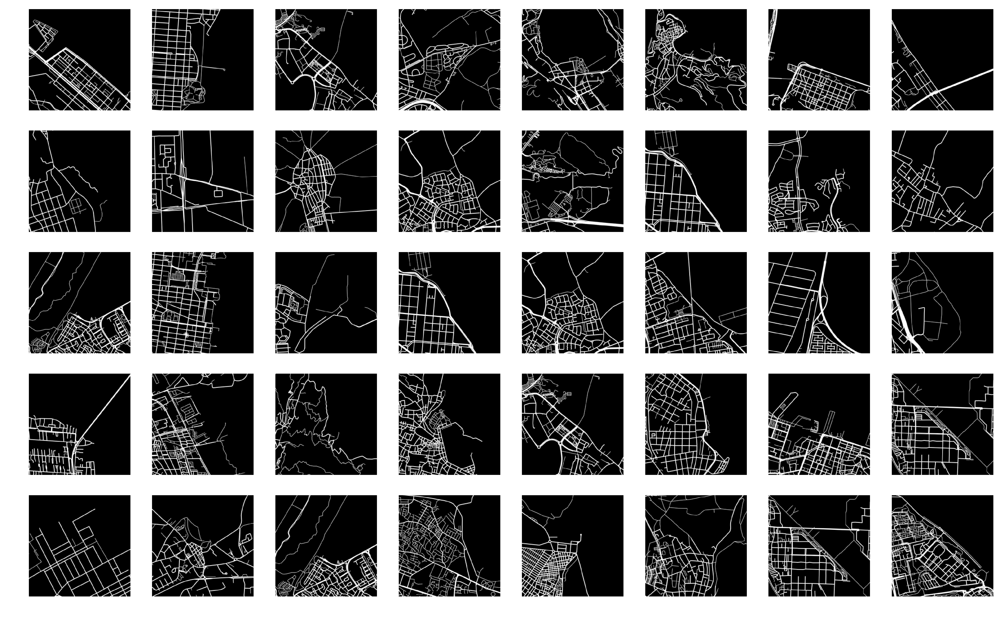

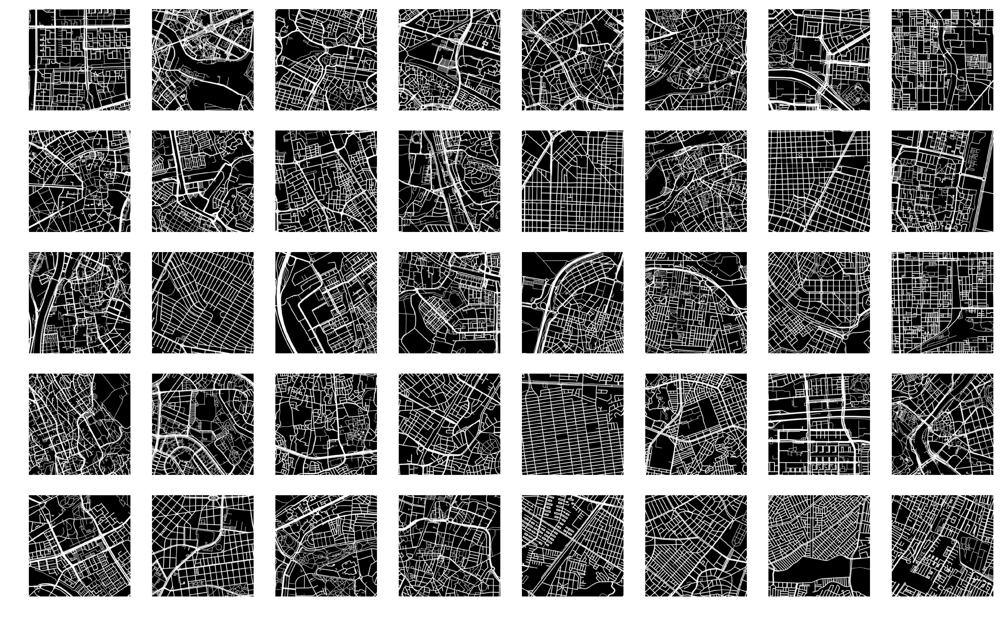

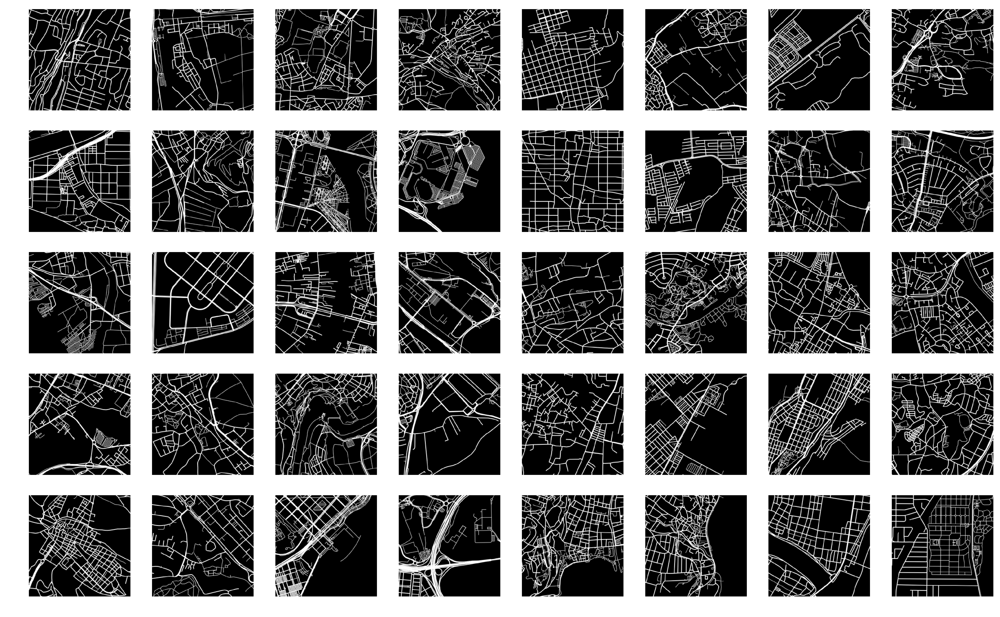

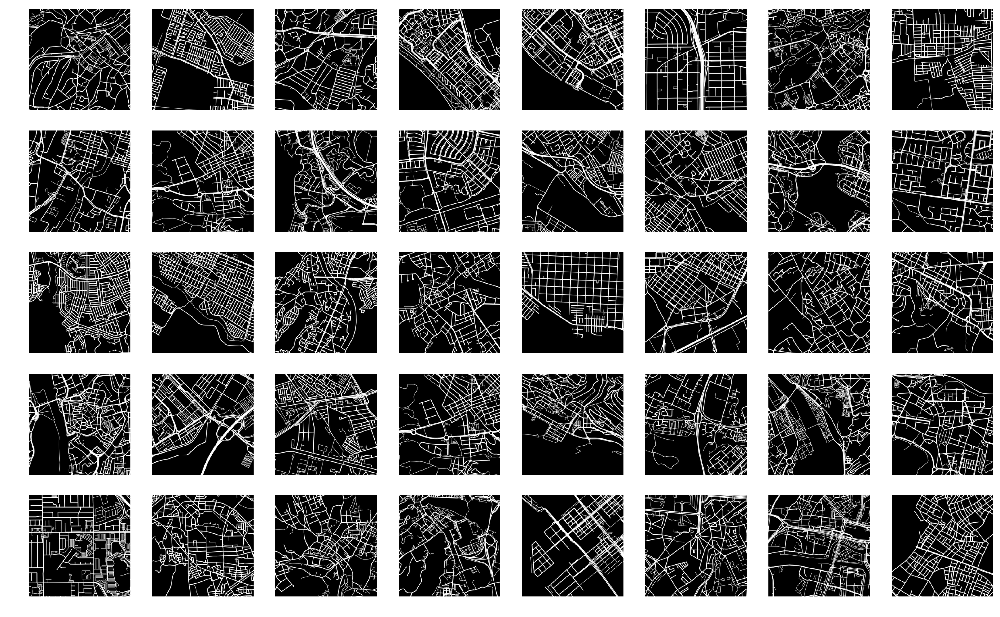

...

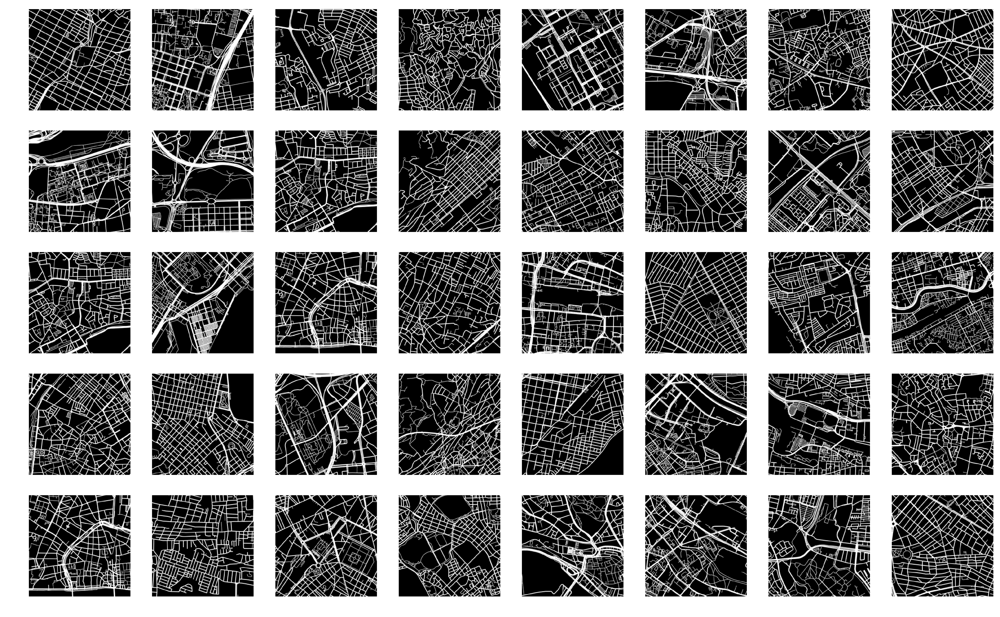

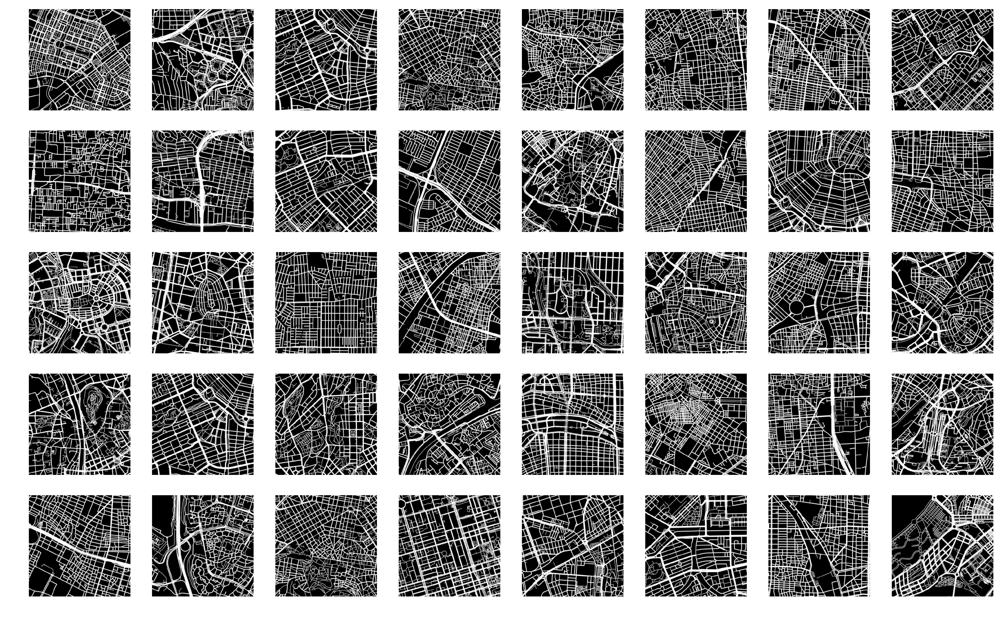

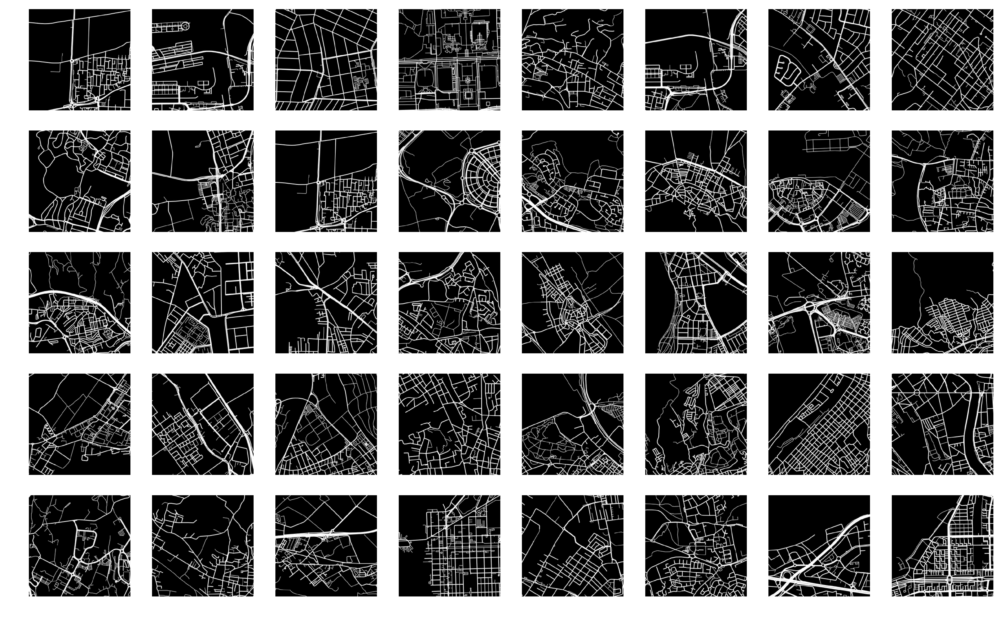

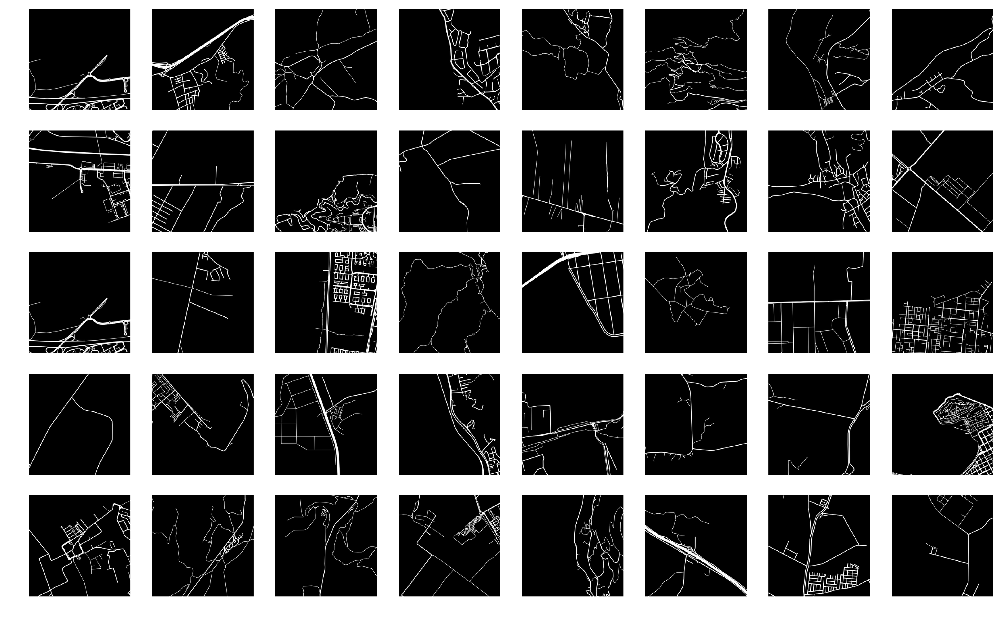

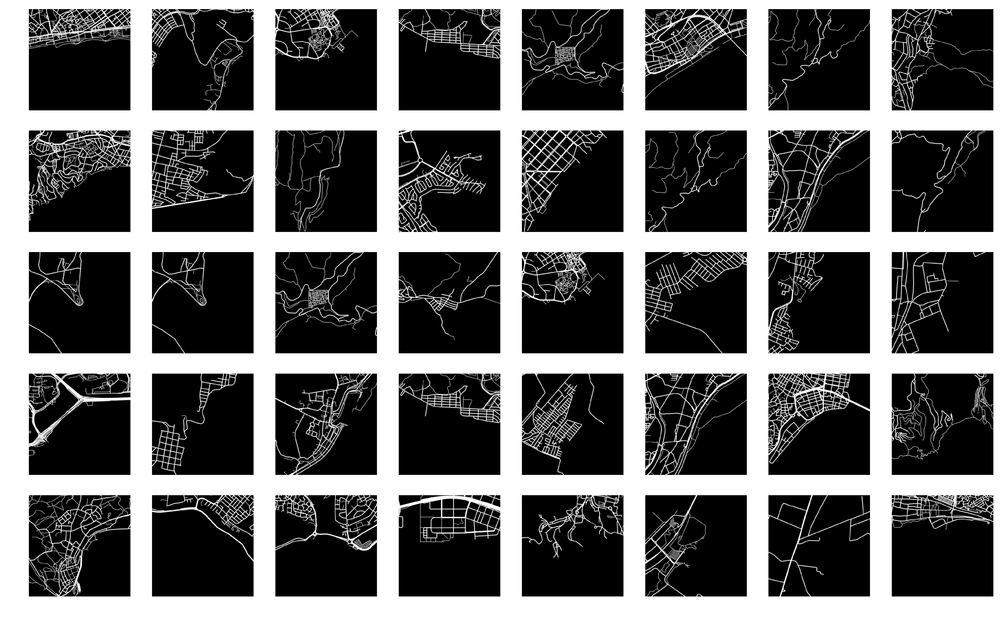

In [14]:
pathname = setup(name, number_clusters, ndim)

df['cluster'] = kMeans(df.set_index('label'), number_clusters=number_clusters)        
df.to_csv(os.path.join(pathname, '{1}.csv'.format(pathname, '{0}_{1}d__cl{2}'.format(name, ndim, str(number_clusters)))))

for cluster in range(number_clusters):
    showBatch(pathname, cluster)

### Geolocate clusters
We can geolocate clusters back for interpretation 

In [189]:
geolabel = pd.read_csv('./_project/labels__new.csv',encoding='ISO-8859-1')
# geolabel['label'] = geolabel['label'].apply(lambda x : x + '.png')

In [190]:
geolabel.head(2)

,label,lon,lat
0,A Coru_1_1453,43.368664,-8.389204
1,A Coru_2_1573,43.368136,-8.403226


In [191]:
len(df); df.head()

,label,x,y
0,_Port of Spain,-4.204391,0.141594
1,_El Paso,10.252559,2.034488
2,CL_545,3.057523,-4.844531
3,MX_825,5.134288,0.669430
4,Almere_39,17.583935,-1.045144


In [192]:
def joingeo(df, label):
    idx = list(df.index[df['label']==label])[0]
    print(geolabel.iloc[idx])
    lon = geolabel.iloc[idx].lon
    lat = geolabel.iloc[idx].lat
    return lon, lat

In [209]:
df = pd.read_csv('./_project/images/clustered/cross_entropy_3d__cl8/cross_entropy_3d__cl8.csv')
df.drop(['Unnamed: 0'], axis=1, inplace=True)
df['label'] = df['label'].apply(lambda x : x.replace('.png',''))
df.head()

,label,x,y,z,cluster
0,_Port of Spain,-10.053673,3.362716,5.916826,5
1,_El Paso,5.989289,1.122345,-2.298684,0
2,CL_545,1.167437,5.708115,-3.582084,7
3,MX_825,3.094105,2.346902,-2.381266,0
4,Almere_39,12.119444,2.184424,-0.324675,4


In [210]:
geolocated= df.merge(geolabel, left_on='label', right_on='label', how='left')
geolocated.to_csv('./_project/images/clustered/cross_entropy_3d__cl8/cross_entropy_3d__cl8__geolocated.csv')

### Plot distributions

In [211]:
import seaborn as sns
gb = geolocated.groupby('cluster')

0
1
2
3
4
5
6
7


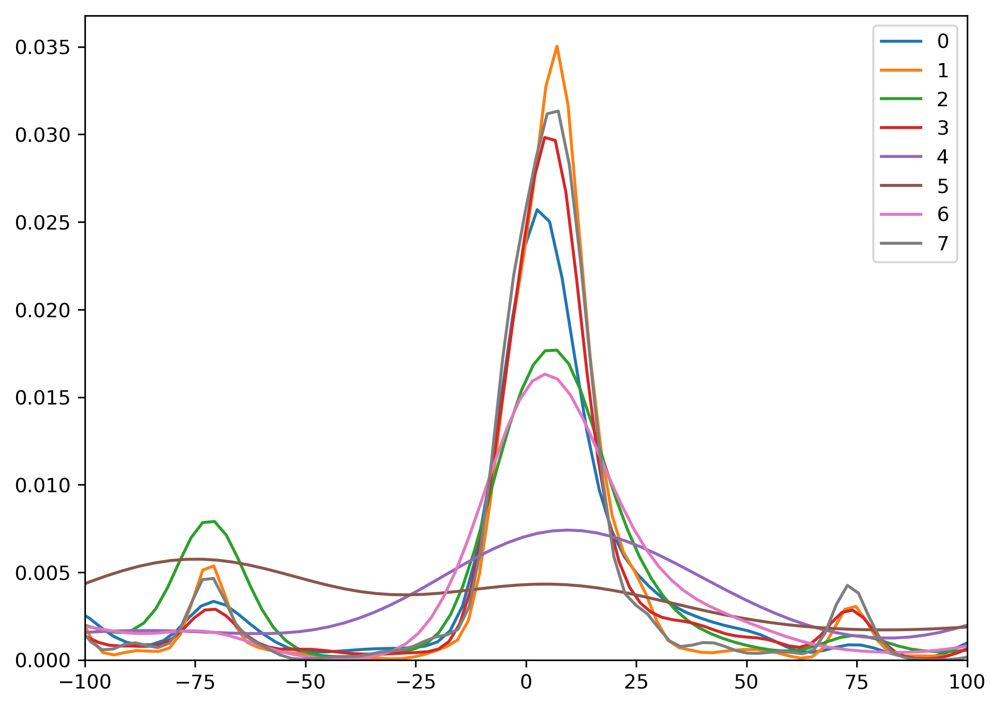

In [218]:
fig, ax = plt.subplots(figsize=(8,6), dpi=300)
for group, data in gb:
    print(group)
    gf = pd.DataFrame(gb.get_group(group))
    sns.kdeplot(gf['lat'], label=group)
ax.set_xlim(-100,100)
plt.show()
    